<a href="https://colab.research.google.com/github/kaustubhydv/Version-Identification/blob/main/Version_Identificationipynb.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Maximum Similarity Calculation**

In [ ]:
# Major references from FMP notebooks by Meinard Mullerimport os
import sys
import numpy as np
import librosa
import matplotlib.pyplot as plt
from IPython.display import display, Audio
import matplotlib.gridspec as gridspec
import signal
import scipy
import matplotlib

audio_file1 = "Original.mp3"
audio_file2 = "Original.mp3"

In [ ]:
def compressed_gray_cmap(alpha=5, N=256, reverse=False):
    assert alpha != 0

    gray_values = np.log(1 + abs(alpha) * np.linspace(0, 1, N))
    gray_values /= gray_values.max()

    if alpha > 0:
        gray_values = 1 - gray_values
    else:
        gray_values = gray_values[::-1]

    if reverse:
        gray_values = gray_values[::-1]

    gray_values_rgb = np.repeat(gray_values.reshape(N, 1), 3, axis=1)
    color_wb = matplotlib.colors.LinearSegmentedColormap.from_list('color_wb', gray_values_rgb, N=N)
    
    return color_wb

In [ ]:
def plot_matrix(X, Fs=1, Fs_F=1, T_coef=None, F_coef=None, xlabel='Time (seconds)', ylabel='Frequency (Hz)',
                xlim=None, ylim=None, clim=None, title='', dpi=72,
                colorbar=True, colorbar_aspect=20.0, cbar_label='', ax=None, figsize=(6, 3), **kwargs):
    fig = None
    if ax is None:
        fig, ax = plt.subplots(1, 1, figsize=figsize, dpi=dpi)
        ax = [ax]
    if T_coef is None:
        T_coef = np.arange(X.shape[1]) / Fs
    if F_coef is None:
        F_coef = np.arange(X.shape[0]) / Fs_F

    if 'extent' not in kwargs:
        x_ext1 = (T_coef[1] - T_coef[0]) / 2
        x_ext2 = (T_coef[-1] - T_coef[-2]) / 2
        y_ext1 = (F_coef[1] - F_coef[0]) / 2
        y_ext2 = (F_coef[-1] - F_coef[-2]) / 2
        kwargs['extent'] = [T_coef[0] - x_ext1, T_coef[-1] + x_ext2, F_coef[0] - y_ext1, F_coef[-1] + y_ext2]
    if 'cmap' not in kwargs:
        kwargs['cmap'] = 'gray_r'
    if 'aspect' not in kwargs:
        kwargs['aspect'] = 'auto'
    if 'origin' not in kwargs:
        kwargs['origin'] = 'lower'
    if 'interpolation' not in kwargs:
        kwargs['interpolation'] = 'nearest'

    im = ax[0].imshow(X, **kwargs)

    if len(ax) == 2 and colorbar:
        cbar = plt.colorbar(im, cax=ax[1])
        cbar.set_label(cbar_label)
    elif len(ax) == 2 and not colorbar:
        ax[1].set_axis_off()
    elif len(ax) == 1 and colorbar:
        plt.sca(ax[0])
        cbar = plt.colorbar(im, aspect=colorbar_aspect)
        cbar.set_label(cbar_label)

    ax[0].set_xlabel(xlabel)
    ax[0].set_ylabel(ylabel)
    ax[0].set_title(title)
    if xlim is not None:
        ax[0].set_xlim(xlim)
    if ylim is not None:
        ax[0].set_ylim(ylim)
    if clim is not None:
        im.set_clim(clim)

    if fig is not None:
        plt.tight_layout()

    return fig, ax, im

In [ ]:
def plot_chromagram(*args, chroma_yticks=np.arange(12), **kwargs):
    if 'ylabel' not in kwargs:
        kwargs['ylabel'] = 'Chroma'
    fig, ax, im = plot_matrix(*args, **kwargs)

    chroma_names = 'C C# D D# E F F# G G# A A# B'.split()
    ax[0].set_yticks(np.array(chroma_yticks))
    ax[0].set_yticklabels([chroma_names[i] for i in chroma_yticks])

    return fig, ax, im

In [ ]:
def quantize_matrix(C, quant_fct=None):
    C_quant = np.empty_like(C)
    if quant_fct is None:
        quant_fct = [(0.0, 0.05, 0), (0.05, 0.1, 1), (0.1, 0.2, 2), (0.2, 0.4, 3), (0.4, 1, 4)]
    for min_val, max_val, target_val in quant_fct:
        mask = np.logical_and(min_val <= C, C < max_val)
        C_quant[mask] = target_val
    return C_quant

In [ ]:
def normalize_feature_sequence(X, norm='2', threshold=0.0001, v=None):
    assert norm in ['1', '2', 'max', 'z']

    K, N = X.shape
    X_norm = np.zeros((K, N))

    if norm == '1':
        if v is None:
            v = np.ones(K, dtype=np.float64) / K
        for n in range(N):
            s = np.sum(np.abs(X[:, n]))
            if s > threshold:
                X_norm[:, n] = X[:, n] / s
            else:
                X_norm[:, n] = v

    if norm == '2':
        if v is None:
            v = np.ones(K, dtype=np.float64) / np.sqrt(K)
        for n in range(N):
            s = np.sqrt(np.sum(X[:, n] ** 2))
            if s > threshold:
                X_norm[:, n] = X[:, n] / s
            else:
                X_norm[:, n] = v

    if norm == 'max':
        if v is None:
            v = np.ones(K, dtype=np.float64)
        for n in range(N):
            s = np.max(np.abs(X[:, n]))
            if s > threshold:
                X_norm[:, n] = X[:, n] / s
            else:
                X_norm[:, n] = v

    if norm == 'z':
        if v is None:
            v = np.zeros(K, dtype=np.float64)
        for n in range(N):
            mu = np.sum(X[:, n]) / K
            sigma = np.sqrt(np.sum((X[:, n] - mu) ** 2) / (K - 1))
            if sigma > threshold:
                X_norm[:, n] = (X[:, n] - mu) / sigma
            else:
                X_norm[:, n] = v

    return X_norm

In [ ]:
def smooth_downsample_feature_sequence(X, Fs, filt_len=41, down_sampling=10, w_type='boxcar'):

    filt_kernel = np.expand_dims(scipy.signal.get_window(w_type, filt_len), axis=0)
    X_smooth = scipy.signal.convolve(X, filt_kernel, mode='same') / filt_len
    X_smooth = X_smooth[:, ::down_sampling]
    Fs_feature = Fs / down_sampling
    return X_smooth, Fs_feature

In [ ]:
def compute_cens_from_chromagram(C, Fs=1, ell=41, d=10, quant=True):
    C_norm = normalize_feature_sequence(C, norm='1')
    C_Q = quantize_matrix(C_norm) if quant else C_norm

    C_smooth, Fs_CENS = smooth_downsample_feature_sequence(C_Q, Fs, filt_len=ell,
                                                                     down_sampling=d, w_type='hann')
    C_CENS = normalize_feature_sequence(C_smooth, norm='2')

    return C_CENS, Fs_CENS

In [ ]:
def shift_cyc_matrix(X, shift=0):
    K, N = X.shape
    shift = np.mod(shift, K)
    X_cyc = np.zeros((K, N))
    X_cyc[shift:K, :] = X[0:K-shift, :]
    X_cyc[0:shift, :] = X[K-shift:K, :]
    return X_cyc

In [ ]:
def filter_diag_mult_sm(S, L=1, tempo_rel_set=np.asarray([1]), direction=0):
    N = S.shape[0]
    M = S.shape[1]
    num = len(tempo_rel_set)
    S_L_final = np.zeros((N, M))

    for s in range(0, num):
        M_ceil = int(np.ceil(M / tempo_rel_set[s]))
        resample = np.multiply(np.divide(np.arange(1, M_ceil+1), M_ceil), M)
        np.around(resample, 0, resample)
        resample = resample - 1
        index_resample = np.maximum(resample, np.zeros(len(resample))).astype(np.int64)
        S_resample = S[:, index_resample]

        S_L = np.zeros((N, M_ceil))
        S_extend_L = np.zeros((N + L, M_ceil + L))

        if direction == 0:
            S_extend_L[0:N, 0:M_ceil] = S_resample
            for pos in range(0, L):
                S_L = S_L + S_extend_L[pos:(N + pos), pos:(M_ceil + pos)]

        if direction == 1:
            S_extend_L[L:(N+L), L:(M_ceil+L)] = S_resample
            for pos in range(0, L):
                S_L = S_L + S_extend_L[(L-pos):(N + L - pos), (L-pos):(M_ceil + L - pos)]

        S_L = S_L / L
        resample = np.multiply(np.divide(np.arange(1, M+1), M), M_ceil)
        np.around(resample, 0, resample)
        resample = resample - 1
        index_resample = np.maximum(resample, np.zeros(len(resample))).astype(np.int64)

        S_resample_inv = S_L[:, index_resample]
        S_L_final = np.maximum(S_L_final, S_resample_inv)

    return S_L_final

In [ ]:
def compute_sm_dot(X, Y):
    S = np.dot(np.transpose(X), Y)
    return S

In [ ]:
def compute_sm_ti(X, Y, L=1, tempo_rel_set=np.asarray([1]), shift_set=np.asarray([0]), direction=2):
    for shift in shift_set:
        Y_cyc = shift_cyc_matrix(Y, shift)
        S_cyc = compute_sm_dot(X, Y_cyc)

        if direction == 0:
            S_cyc = filter_diag_mult_sm(S_cyc, L, tempo_rel_set, direction=0)
        if direction == 1:
            S_cyc = filter_diag_mult_sm(S_cyc, L, tempo_rel_set, direction=1)
        if direction == 2:
            S_forward = filter_diag_mult_sm(S_cyc, L, tempo_rel_set=tempo_rel_set, direction=0)
            S_backward = filter_diag_mult_sm(S_cyc, L, tempo_rel_set=tempo_rel_set, direction=1)
            S_cyc = np.maximum(S_forward, S_backward)
        if shift == shift_set[0]:
            S_TI = S_cyc
            I_TI = np.ones((S_cyc.shape[0], S_cyc.shape[1])) * shift
        else:
            I_TI[S_cyc > S_TI] = shift
            S_TI = np.maximum(S_cyc, S_TI)

    return S_TI, I_TI

In [ ]:
def threshold_matrix(S, thresh, strategy='absolute', scale=False, penalty=0.0, binarize=False):
    if np.min(S) < 0:
        raise Exception('All entries of the input matrix must be nonnegative')

    S_thresh = np.copy(S)
    N, M = S.shape
    num_cells = N * M

    if strategy == 'absolute':
        thresh_abs = thresh
        S_thresh[S_thresh < thresh] = 0

    if strategy == 'relative':
        thresh_rel = thresh
        num_cells_below_thresh = int(np.round(S_thresh.size*(1-thresh_rel)))
        if num_cells_below_thresh < num_cells:
            values_sorted = np.sort(S_thresh.flatten('F'))
            thresh_abs = values_sorted[num_cells_below_thresh]
            S_thresh[S_thresh < thresh_abs] = 0
        else:
            S_thresh = np.zeros([N, M])

    if strategy == 'local':
        thresh_rel_row = thresh[0]
        thresh_rel_col = thresh[1]
        S_binary_row = np.zeros([N, M])
        num_cells_row_below_thresh = int(np.round(M * (1-thresh_rel_row)))
        for n in range(N):
            row = S[n, :]
            values_sorted = np.sort(row)
            if num_cells_row_below_thresh < M:
                thresh_abs = values_sorted[num_cells_row_below_thresh]
                S_binary_row[n, :] = (row >= thresh_abs)
        S_binary_col = np.zeros([N, M])
        num_cells_col_below_thresh = int(np.round(N * (1-thresh_rel_col)))
        for m in range(M):
            col = S[:, m]
            values_sorted = np.sort(col)
            if num_cells_col_below_thresh < N:
                thresh_abs = values_sorted[num_cells_col_below_thresh]
                S_binary_col[:, m] = (col >= thresh_abs)
        S_thresh = S * S_binary_row * S_binary_col

    if scale:
        cell_val_zero = np.where(S_thresh == 0)
        cell_val_pos = np.where(S_thresh > 0)
        if len(cell_val_pos[0]) == 0:
            min_value = 0
        else:
            min_value = np.min(S_thresh[cell_val_pos])
        max_value = np.max(S_thresh)
        if max_value > min_value:
            S_thresh = np.divide((S_thresh - min_value), (max_value - min_value))
            if len(cell_val_zero[0]) > 0:
                S_thresh[cell_val_zero] = penalty
        else:
            print('Condition max_value > min_value is voliated: output zero matrix')

    if binarize:
        S_thresh[S_thresh > 0] = 1
        S_thresh[S_thresh < 0] = 0
    return S_thresh

In [ ]:
def colormap_penalty(penalty=-2, cmap=compressed_gray_cmap(alpha=5)):
    if isinstance(cmap, str):
        cmap = matplotlib.cm.get_cmap(cmap, 128)
    cmap_matrix = cmap(np.linspace(0, 1, 128))[:, :3]
    num_row = int(np.abs(penalty)*128)
    cmap_penalty = np.concatenate((np.ones((num_row, 3)), cmap_matrix), axis=0)
    cmap_penalty = matplotlib.colors.ListedColormap(cmap_penalty)

    return cmap_penalty

In [ ]:
def compute_sm_from_wav(x1, x2, Fs, N=4410, H=2205, ell=21, d=5, L_smooth=12,
                        tempo_rel_set=np.array([0.66, 0.81, 1, 1.22, 1.5]),
                        shift_set=np.array([0]), strategy='relative', scale=True,
                        thresh=0.15, penalty=-2.0, binarize=False):

    C1 = librosa.feature.chroma_stft(y=x1, sr=Fs, tuning=0, norm=1, hop_length=H, n_fft=N)
    C2 = librosa.feature.chroma_stft(y=x2, sr=Fs, tuning=0, norm=1, hop_length=H, n_fft=N)
    Fs_C = Fs / H
    X, Fs_feature = compute_cens_from_chromagram(C1, Fs_C, ell=ell, d=d)
    Y, Fs_feature = compute_cens_from_chromagram(C2, Fs_C, ell=ell, d=d)

    S, I = compute_sm_ti(X, Y, L=L_smooth,  tempo_rel_set=tempo_rel_set,
                                   shift_set=shift_set, direction=2)
    S_thresh = threshold_matrix(S, thresh=thresh, strategy=strategy,
                                          scale=scale, penalty=penalty, binarize=binarize)
    return X, Y, Fs_feature, S_thresh, I

fn1 = audio_file1
fn2 = audio_file2
Fs = 22050
x1, Fs = librosa.load(fn1, sr=Fs)
x2, Fs = librosa.load(fn2, sr=Fs)

penalty=-2
tempo_rel_set=np.array([0.8, 1, 1.2])
L_smooth = 20
X, Y, Fs_X, S, I = compute_sm_from_wav(x1, x2, Fs, tempo_rel_set = tempo_rel_set,
                                              L_smooth=L_smooth, penalty=penalty)

cmap_penalty = colormap_penalty(penalty=penalty)

figsize=(8, 4)

In [ ]:
def compute_accumulated_score_matrix_common_subsequence(S):
    N, M = S.shape
    D = np.zeros((N, M))

    D[0, 0] = max(0, S[0, 0])

    for n in range(1, N):
        D[n, 0] = max(0, D[n-1, 0] + S[n, 0])

    for m in range(1, M):
        D[0, m] = max(0, D[0, m-1] + S[0, m])

    for n in range(1, N):
        for m in range(1, M):
            D[n, m] = max(0, D[n-1, m-1] + S[n, m], D[n-1, m] + S[n, m], D[n, m-1] + S[n, m])

    return D

In [ ]:
def compute_optimal_path_common_subsequence(D, cellmax=True, n=0, m=0):
    if cellmax:
        n, m = divmod(np.argmax(D), D.shape[1])
    P = [(n, m)]

    while ((n, m) != (0, 0) and (D[n, m] != 0)):
        if n == 0:
            cell = (0, m-1)
        elif m == 0:
            cell = (n-1, 0)
        else:
            val = max(D[n-1, m-1], D[n-1, m], D[n, m-1])
            if val == D[n-1, m-1]:
                cell = (n-1, m-1)
            elif val == D[n-1, m]:
                cell = (n-1, m)
            else:
                cell = (n, m-1)
        P.append(cell)
        n, m = cell
    if (D[n, m] == 0):
        del P[-1]
    P.reverse()
    P = np.array(P)
    return P

In [ ]:
def get_induced_segments(P):
    seg_X = np.arange(P[0, 0], P[-1, 0] + 1)
    seg_Y = np.arange(P[0, 1], P[-1, 1] + 1)
    return seg_X, seg_Y

In [ ]:
D = compute_accumulated_score_matrix_common_subsequence(S)
DMAX = np.max(D)
print('DMAX = %.2f' % DMAX)

DMAX = 950.15


# **Overall Similarity Score Calculation and Results**

In [ ]:
audio_file3 = "Boyce Avenue.mp3"

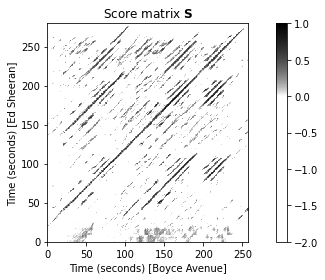

In [ ]:
def compute_sm_from_wav(x1, x2, Fs, N=4410, H=2205, ell=21, d=5, L_smooth=12,
                        tempo_rel_set=np.array([0.66, 0.81, 1, 1.22, 1.5]),
                        shift_set=np.array([0]), strategy='relative', scale=True,
                        thresh=0.15, penalty=-2.0, binarize=False):

    C1 = librosa.feature.chroma_stft(y=x1, sr=Fs, tuning=0, norm=1, hop_length=H, n_fft=N)
    C2 = librosa.feature.chroma_stft(y=x2, sr=Fs, tuning=0, norm=1, hop_length=H, n_fft=N)
    Fs_C = Fs / H
    X, Fs_feature = compute_cens_from_chromagram(C1, Fs_C, ell=ell, d=d)
    Y, Fs_feature = compute_cens_from_chromagram(C2, Fs_C, ell=ell, d=d)

    S, I = compute_sm_ti(X, Y, L=L_smooth,  tempo_rel_set=tempo_rel_set,
                                   shift_set=shift_set, direction=2)
    S_thresh = threshold_matrix(S, thresh=thresh, strategy=strategy,
                                          scale=scale, penalty=penalty, binarize=binarize)
    return X, Y, Fs_feature, S_thresh, I

fn1 = audio_file1
fn2 = audio_file3
Fs = 22050
x1, Fs = librosa.load(fn1, sr=Fs)
x2, Fs = librosa.load(fn2, sr=Fs)

penalty=-2
tempo_rel_set=np.array([0.8, 1, 1.2])
L_smooth = 20
X, Y, Fs_X, S, I = compute_sm_from_wav(x1, x2, Fs, tempo_rel_set = tempo_rel_set,
                                              L_smooth=L_smooth, penalty=penalty)

cmap_penalty = colormap_penalty(penalty=penalty)

figsize=(8, 4)
plot_matrix(S, figsize=figsize, cmap=cmap_penalty, 
                     Fs=Fs_X, Fs_F=Fs_X, aspect='equal',
                     title='Score matrix $\mathbf{S}$', 
                     xlabel='Time (seconds) [Boyce Avenue]', 
                     ylabel='Time (seconds) [Ed Sheeran]')

plt.tight_layout()

In [ ]:
def compute_accumulated_score_matrix_common_subsequence(S):
    N, M = S.shape
    D = np.zeros((N, M))

    D[0, 0] = max(0, S[0, 0])

    for n in range(1, N):
        D[n, 0] = max(0, D[n-1, 0] + S[n, 0])

    for m in range(1, M):
        D[0, m] = max(0, D[0, m-1] + S[0, m])

    for n in range(1, N):
        for m in range(1, M):
            D[n, m] = max(0, D[n-1, m-1] + S[n, m], D[n-1, m] + S[n, m], D[n, m-1] + S[n, m])

    return D

In [ ]:
def compute_optimal_path_common_subsequence(D, cellmax=True, n=0, m=0):
    if cellmax:
        n, m = divmod(np.argmax(D), D.shape[1])
    P = [(n, m)]

    while ((n, m) != (0, 0) and (D[n, m] != 0)):
        if n == 0:
            cell = (0, m-1)
        elif m == 0:
            cell = (n-1, 0)
        else:
            val = max(D[n-1, m-1], D[n-1, m], D[n, m-1])
            if val == D[n-1, m-1]:
                cell = (n-1, m-1)
            elif val == D[n-1, m]:
                cell = (n-1, m)
            else:
                cell = (n, m-1)
        P.append(cell)
        n, m = cell
    if (D[n, m] == 0):
        del P[-1]
    P.reverse()
    P = np.array(P)
    return P

In [ ]:
def get_induced_segments(P):
    seg_X = np.arange(P[0, 0], P[-1, 0] + 1)
    seg_Y = np.arange(P[0, 1], P[-1, 1] + 1)
    return seg_X, seg_Y

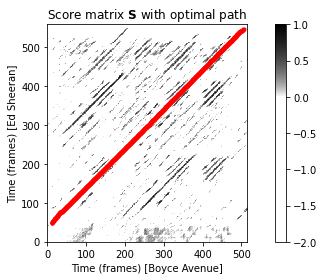

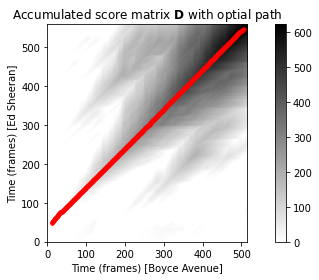

Maximizing cell (n, m) = (547, 506)
Induced segment for X: [48:547]
Induced segment for Y: [12:506]


In [ ]:
D = compute_accumulated_score_matrix_common_subsequence(S)
Dmax = np.max(D)
n, m = divmod(np.argmax(D), D.shape[1])
P = compute_optimal_path_common_subsequence(D)
seg_X, seg_Y = get_induced_segments(P)

figsize = (8, 4)
plot_matrix(S, figsize=figsize, cmap=cmap_penalty, Fs=1, Fs_F=1, aspect='equal',
                     title='Score matrix $\mathbf{S}$ with optimal path', 
                     xlabel='Time (frames) [Boyce Avenue]', 
                     ylabel='Time (frames) [Ed Sheeran]')
plt.plot(P[:, 1], P[:, 0], marker='.', color='r')
plt.tight_layout()

figsize = (8, 4)
plot_matrix(D, figsize=figsize, cmap='gray_r', Fs=1, Fs_F=1, aspect='equal',
                     title='Accumulated score matrix $\mathbf{D}$ with optial path', 
                     xlabel='Time (frames) [Boyce Avenue]', 
                     ylabel='Time (frames) [Ed Sheeran]')
plt.plot(P[:, 1], P[:, 0], marker='.', color='r')
plt.tight_layout()
plt.show()


print('Maximizing cell (n, m) = (%d, %d)' % (n, m))
print('Induced segment for X: [%d:%d]' % (seg_X[0], seg_X[-1]))
print('Induced segment for Y: [%d:%d]' % (seg_Y[0], seg_Y[-1]))

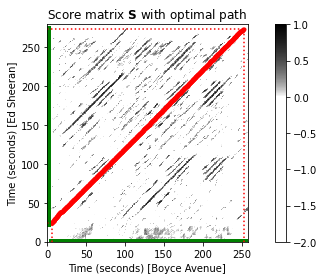

Induced segment of the original version (Ed Sheeran):


Induced segment of the cover version (Boyce Avenue):


In [ ]:
figsize = (8, 4)
plot_matrix(S, figsize=figsize, cmap=cmap_penalty, Fs=Fs_X, Fs_F=Fs_X, aspect='equal',
                     title='Score matrix $\mathbf{S}$ with optimal path', 
                     xlabel='Time (seconds) [Boyce Avenue]', 
                     ylabel='Time (seconds) [Ed Sheeran]')
plt.plot(P[:, 1] / Fs_X, P[:, 0] / Fs_X, marker='.', color='r')

start_X, start_Y = P[0, :] / Fs_X
end_X, end_Y = P[-1, :] / Fs_X

plt.plot([0, 0], [start_X, end_X], c='g', linewidth=7)
plt.plot([start_Y, end_Y], [0, 0], c='g', linewidth=7)

plt.plot([0, start_Y], [start_X, start_X], c='r', linestyle=':')
plt.plot([0, end_Y], [end_X, end_X], c='r', linestyle=':')

plt.plot([start_Y, start_Y], [0, start_X], c='r', linestyle=':')
plt.plot([end_Y, end_Y], [0, end_X], c='r', linestyle=':')
plt.tight_layout()
plt.show()

print('Induced segment of the original version (Ed Sheeran):')
display(Audio(x1[int(start_X * Fs):int(end_X * Fs)], rate=Fs))
print('Induced segment of the cover version (Boyce Avenue):')
display(Audio(x2[int(start_Y * Fs):int(end_Y * Fs)], rate=Fs))

In [ ]:
print('Overall Similarity score Dmax = %.2f' % Dmax)
percentage = Dmax/DMAX * 100
print('Percentage Similarity = %.2f' % percentage)

Overall Similarity score Dmax = 621.14
Percentage Similarity = 65.37
